# Julia言語によるLangevin方程式の数値計算

横浜市立大学大学院
<br>生命ナノシステム科学研究科 前期博士課程 物質システム科学専攻
<br>量子物理化学研究室

大野 周平

2021年10月23日(土) @ [第8回 ぶつりがく徒のつどい](http://physicstsudoi.client.jp/Info.html)

## 目次

- はじめに
    1. GitHub
    2. 起動方法
    2. Julia言語
    3. Julia in Physics 2021 Online
    4. サンプルコード
    5. 目標
- 第１部
    1. [Brown(1828)](https://doi.org/10.1080/14786442808674769)
    2. Einsteinまでの80年間
    3. [Bachelier(1900)](https://doi.org/10.24033/asens.476)
    4. [Einstein(1905)](https://doi.org/10.1002/andp.19053220806)
    5. [Smoluchowski(1906)](https://doi.org/10.1002/andp.19063261405)
    6. [Perrin(1908)](https://gallica.bnf.fr/ark:/12148/bpt6k3100t/f969.item)
    7. [Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)
    6. まとめ
- 第２部
    1. 確率過程
    2. ランダムウォークモデル
    3. 白色雑音とWiener過程
    4. 白色雑音を取り巻く問題点
    4. 確率微分方程式
    5. Fokker-Planck方程式
    6. Eular-Maruyama法
    7. 数値計算：Wiener過程
    8. 数値計算：ドリフト項のあるWiener過程
    9. 数値計算：Ornstein–Uhlenbeck過程
    10. まとめ
- 第３部
    1. Langevin方程式
    2. Langevin方程式の離散化
    3. 平均二乗変位
    4. 北原の罠
    5. 数値計算：Langevin方程式
    6. 数値計算：Wiener過程
    7. 拡散係数の過小評価について
    8. まとめ
- おわりに
    1. 参考文献
    2. 補助資料

## はじめに

本講演ではLangevin方程式の歴史背景と数値解法について概説する.

### GitHub

資料は全て https://github.com/ohno/butsudoi2021 にアップロードしてある.

質問・指摘等は https://github.com/ohno/butsudoi2021/discussions にお願いします.

### 起動方法

このノートの起動方法：

1. Juliaをインストールする.
[https://julialang.org/downloads/](https://julialang.org/downloads/)
2. Juliaを起動し, REPLに`]`を入力してパッケージモードを起動する. 次の通り入力し, パッケージを全てインストールする. 1つ1つ時間がかかるので気長に待つ.
```
]
add Plots
add IJulia
```
3. このノートをダウンロードする. https://github.com/ohno/butsudoi2021 のdocument/document.ipynbを保存すればよい.
4. コマンドプロンプトに以下を入力し, Jupyter Notebookを起動する. 少し待つと勝手にブラウザが起動するはずなので, あとは見ればわかる.
```
julia -e "using IJulia; notebook(detached=true)"
```

### Julia言語

[Julia言語](https://julialang.org/)とは2018年にバージョン1.0がリリースされた
>Pythonのように書けて, Cのように動く　―　[進藤裕之,佐藤建太『1から始めるJuliaプログラミング』](https://www.coronasha.co.jp/np/isbn/9784339029055/) p.1

次世代のプログラミング言語である. JuliaはPythonの書きやすさとCの速さを両立しており, さらにFortranに比類する強力な配列操作と行列演算が可能である. 単体での性能もさることながら, Python, C, Fortranの豊富なライブラリを呼び出すなど, 他言語との糊の役割を果たすグルー言語としても優秀である. 以上に説明した通り, Julia言語は速さ, 書きやすさ, 連携性など, 計算科学における標準語として活躍できるだけの資質を備えている.

また, Julia言語の疑似乱数には[dSFMT](http://www.math.sci.hiroshima-u.ac.jp/m-mat/MT/SFMT/#dSFMT)が採用されており, 特別な準備をせずに良質な疑似乱数を用いてモンテカルロ計算を行うことができる.

### Julia in Physics 2021 Online

[Julia in Physics 2021 Online](https://akio-tomiya.github.io/julia_in_physics/)　2021年9月3日(金) 13:30～

Juliaの入門講座や物理学における使用例の紹介があった. スライドや講演動画がアップロードされているので, Juliaに入門したい方におすすめ.

- [いまから使えるJulia言語](https://akio-tomiya.github.io/julia_in_physics/#1-%E3%81%84%E3%81%BE%E3%81%8B%E3%82%89%E4%BD%BF%E3%81%88%E3%82%8Bjulia%E8%A8%80%E8%AA%9E)<br>→ Juliaのインストール方法(スライドp.14)はこちらを参照
- [jupyterとGoogle colabで使うjulia入門](https://akio-tomiya.github.io/julia_in_physics/#2-jupyter%E3%81%A8google-colab%E3%81%A7%E4%BD%BF%E3%81%86julia%E5%85%A5%E9%96%80)<br>→ Jupyter Notebookのインストール方法(スライドp.13)や使い方など

### サンプルコード

Plots.jlの入門的内容は[こちらのノート](https://gist.github.com/ohno/78d55921c3f88b50a7fb1835be132bcd)にまとめてある. `plot()`を使用するためには事前に`using Plots`を宣言しておく必要がある.

In [210]:
versioninfo()
# using Pkg
# Pkg.add("Plots")
using Plots
using Printf

Julia Version 1.6.2
Commit 1b93d53fc4 (2021-07-14 15:36 UTC)
Platform Info:
  OS: Windows (x86_64-w64-mingw32)
  CPU: Intel(R) Core(TM) i7-4650U CPU @ 1.70GHz
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-11.0.1 (ORCJIT, haswell)


以下に計算と描写の簡単な例を列挙する.

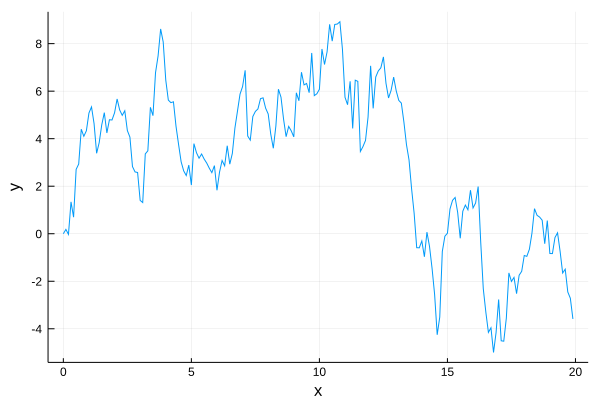

In [198]:
# `plot()`を使用するためには事前に`using Plots`を宣言しておく必要がある.
# using Plots

# 型の宣言は不要である. zeros()は値が全て0の配列を生成する
step = 200
dt = 0.1
X = zeros(step)
Y = zeros(step)

# For文は以下のように書く, randn()は平均0分散1の正規分布に従う疑似乱数.
for i in 2:step
    X[i] = X[i-1] + dt
    Y[i] = Y[i-1] + randn()
end

# 描写するにはplot(X,Y)のようにx座標とy座標それぞれの配列を渡す.
plot(X, Y, label="", xlabel="x", ylabel="y")

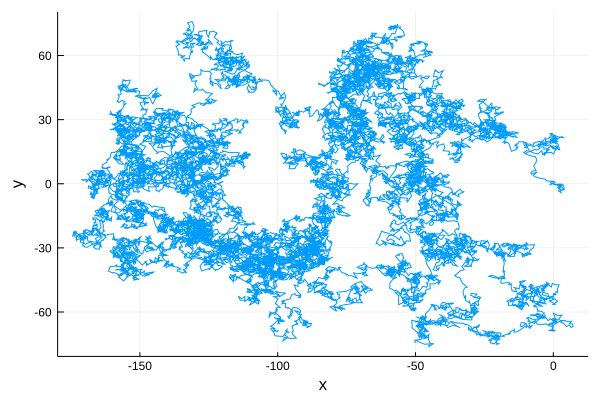

In [200]:
# `plot()`を使用するためには事前に`using Plots`を宣言しておく必要がある.
# using Plots

# 型の宣言は不要である. zeros()は値が全て0の配列を生成する
step = 20000
X = zeros(step)
Y = zeros(step)

# For文は以下のように書く, randn()は平均0分散1の正規分布に従う疑似乱数.
for i in 2:step
    X[i] = X[i-1] + randn()
    Y[i] = Y[i-1] + randn()
end

# 描写するにはplot(X,Y)のようにx座標とy座標それぞれの配列を渡す.
plot(X, Y, label="", xlabel="x", ylabel="y")

# 保存する場合は`savefig("sample.svg")`のようにする
savefig("sample.svg")
plot!()

In [201]:
a = rand()           # [0,1)の一様乱数
b = rand(5)          # [0,1)の一様乱数を5個並べた配列
c = 3*rand() + 2     # [2,5)の一様乱数
d = 3*rand(5) .+ 2   # [2,5)の一様乱数を5個並べた配列

e = randn()          # 平均0,分散1のガウス分布N(0,1)に従う乱数
f = randn(5)         # 平均0,分散1のガウス分布N(0,1)に従う乱数を5個並べた配列
g = 3*randn() + 2    # 平均2,分散3のガウス分布N(2,3)に従う乱数
h = 3*randn(5) .+ 2  # 平均2,分散3のガウス分布N(2,3)に従う乱数を5個並べた配列

5-element Vector{Float64}:
 4.187317047751702
 2.190451205397384
 3.6358881574654913
 3.2214652523509644
 0.9145491526840048

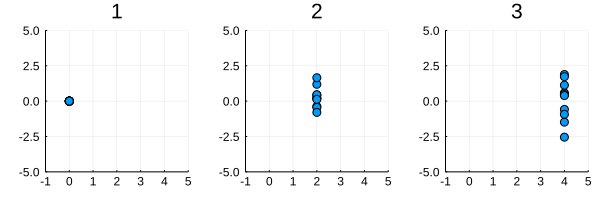

In [174]:
X = zeros(10)
Y = zeros(10)
plt1 = scatter(X, Y, label="", title="1", xlims=(-1,5), ylims=(-5,5))

X .+= 2
Y += randn(10)
plt2 = scatter(X, Y, label="", title="2", xlims=(-1,5), ylims=(-5,5))

X .+= 2
Y += randn(10)
plt3 = scatter(X, Y, label="", title="3", xlims=(-1,5), ylims=(-5,5))

plot(plt1, plt2, plt3, layout=(1,3), size=(600,200))

### 目標

このノートでの最終目標は, 拡散方程式のMSDではなく, __Langevin方程式のMSDを数値的に再現すること__である.

Brown運動については既に語り尽くされた部分が多いように思われるが, その運動方程式である__Langevin方程式__を__3次元__で, かつ__慣性__もまじめに扱って__平均二乗変位__（MSD）を導出している和書は恐らく [北原和夫『岩波基礎物理シリーズ 8 非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html) のみだと思われる. そのため, 拡散方程式とLangevin方程式の与える平均二乗変位が異なるものであることはあまり知られていないのではないだろうか.

|名称|拡散方程式|Langevin方程式|
|:---:|:---:|:---:|
|方程式|$$\frac{\partial P(\pmb{x},t)}{\partial t}=D\nabla^2 P(\pmb{x},t)$$|$$m\frac{\mathrm{d}\pmb{V}(t)}{\mathrm{d}t} = -\gamma \pmb{V}(t) + \pmb{R}(t)$$|
|MSD|$$\langle\|\pmb{X}(t)\|^2\rangle = 2nDt$$|$$\langle\|\pmb{X}(t)\|^2\rangle = 2n\frac{D_u m}{\gamma^3} \left(\frac{\gamma}{m} t+e^{-\frac{\gamma}{m} t}-1 \right)$$|

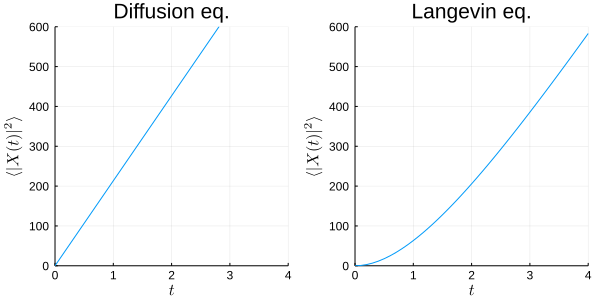

In [207]:
n = 2       # 次元
m  = 0.2    # 質量
Du = 1.2    # 揺動力の強さ（拡散係数Dではない）
γ = 0.15   # 粘性抵抗の強さ
D = Du/γ^2 # 拡散係数（Einsteinの関係式）
Langevin(t) = 2*n*Du*m/(γ^3)*(γ/m*t+exp(-γ/m*t)-1)
Diffusion(t) = 2*n*D*t

plt = []
push!(plt, plot(0:0.1:4, Diffusion, label="", title="Diffusion eq.", xlabel="\$t\$", ylabel="\$\\langle|X(t)|^2\\rangle\$"))
push!(plt, plot(0:0.1:4, Langevin, label="", title="Langevin eq.", xlabel="\$t\$", ylabel="\$\\langle|X(t)|^2\\rangle\$"))
plot(plt..., xlims=(0,4), ylims=(0,600), size=(600,300))

savefig("DiffusionVsLangevin.svg")
plot!()

#### 初めてこのグラフを見た人の反応

- こんなの見たことない → 僕も[北原和夫『非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html)でしか見たことないです.
- 異常拡散では？ → 厳密なBrown運動のMSDはこうらしいです.
- 出典は？ → [北原和夫『非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html)です.
- 合ってるの？ → [北原和夫『非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html)に書いてあります.
- 積分難しい！ → 数値計算で検証してみましょう！

## 第１部

[Brown(1828)](https://doi.org/10.1080/14786442808674769), [Einstein(1905)](https://doi.org/10.1002/andp.19053220806), [Perrin(1908)](https://gallica.bnf.fr/ark:/12148/bpt6k3100t/f969.item), [Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)の一連の研究について簡単に紹介する. [Einstein(1905)](https://doi.org/10.1002/andp.19053220806)は拡散方程式, [Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)は Langevin 方程式を出発点として等価な結果を導いたが, 本来, これらの方程式の与える平均二乗変位は異なるものである. 則ち両者を等価たらしめる何らかの仮定が置かれている.

### Brown(1828)

Brownは[Brown(1828)](https://doi.org/10.1080/14786442808674769)において, 液体中の微粒子が見せるランダムな運動(Brown運動)が<b>生命現象である可能性を否定</b>した. Brownの功績は, Brown運動を物理学の世界へと持ち込んだことである. また, <b>Brown運動はBrownが最初に発見したわけではない</b>ことは本人も明言しており, 先行研究を挙げている.

> never considered by me as wholly original　―　[Brown(1828)](https://doi.org/10.1080/14786442808674769) p.171

[Wikipedia『ブラウン運動にまつわる誤解』](https://ja.wikipedia.org/wiki/%E3%83%96%E3%83%A9%E3%82%A6%E3%83%B3%E9%81%8B%E5%8B%95%E3%81%AB%E3%81%BE%E3%81%A4%E3%82%8F%E3%82%8B%E8%AA%A4%E8%A7%A3)によると, Brownの観察した微粒子は<b>よく花粉と間違えられる</b>と書いてある. 例えば, 

>Brown運動は水に浮かぶ花粉の不規則運動<br>―　L.カラザス, S.E.シュレーブ著, 渡邉壽夫訳『ブラウン運動と確率積分』(丸善出版, 2012) 第2章 2.1序論

などがある. 実験の詳細については[米沢登美子『物理学 One Point - 27 ブラウン運動』(共立出版, 1986)](https://www.kyoritsu-pub.co.jp/bookdetail/9784320032361) 第1章や[池田信行『偶然の輝き ブラウン運動を巡る2000年』(岩波書店, 2018)](https://www.iwanami.co.jp/book/b427307.html) 第3章が詳しい.

### Einsteinまでの80年間

[Einstein(1905)](https://doi.org/10.1002/andp.19053220806)の論文中で使用されるStokesの式が[Stokes(1851)](https://babel.hathitrust.org/cgi/pt?id=mdp.39015012112531&view=1up&seq=220), 濃度場についての拡散方程式が[Fick(1855)](https://doi.org/10.1080/14786445508641925), 分子運動論による理想気体の状態方程式の導出が[Krönig(1856)](https://doi.org/10.1002/andp.18561751008), [Clausius(1857)](https://doi.org/10.1002/andp.18571760302), van't Hoffの式が[van't Hoff(1884)](https://doi.org/10.1002/recl.18840031003), 等分配則によるBrown運動の説明の失敗が[Exner(1900)](https://doi.org/10.1002/andp.19003070813)などであるから, 前提となる数学や物理学の発展を踏まえると, Einsteinまでの80年間は長過ぎるということはないだろう.

Brown運動の軌道は[自己相似性](https://en.wikipedia.org/wiki/Wiener_process#/media/File:Wiener_process_animated.gif)を持ち, <b>フラクタル</b>図形（に近いもの）であって, その長さを測定しようとすると[海岸線のパラドックス](https://ja.wikipedia.org/wiki/%E6%B5%B7%E5%B2%B8%E7%B7%9A%E3%81%AE%E3%83%91%E3%83%A9%E3%83%89%E3%83%83%E3%82%AF%E3%82%B9)と同じ問題が生じる（[Brown運動のフラクタル次元は2](http://umdb.um.u-tokyo.ac.jp/DKankoub/Publish_db/2006jiku_design/sano.html)である）. 下図のように速度(単位時間当たりの移動距離)が観測頻度に依存してしまう.

> アインシュタインの理論が成功したのは, ブラウン粒子の速度に関する部分を表向き回避した点にあると言ってもよい.<br>―　[米沢登美子『物理学 One Point - 27 ブラウン運動』(共立出版, 1986)](https://www.kyoritsu-pub.co.jp/bookdetail/9784320032361) p.50

> アインシュタインの方法は, 次の三つの点で決定的に重要な前進を遂げた. (1) 等分配則にではなく, 浸透圧にもとづいて分析を行ったこと. (2) 観測できるのは懸濁粒子の速度ではなく, 平均2乗変位であるとしたこと. (3) 熱の分子運動論とマクロな散逸構造という二つの概念的道具を, 前者は分子スケールの現象に, 後者はマクロなスケールの現象にと, 別々に用いるのではなく, ひとつの現象にふたつの道具を同時に用いたこと.<br>―　[ジョン・スタチェル編, 青木薫訳『アインシュタイン論文選「奇跡の年」の5論文』(ちくま学芸
文庫, 2011)](https://www.chikumashobo.co.jp/product/9784480094032/) p.194

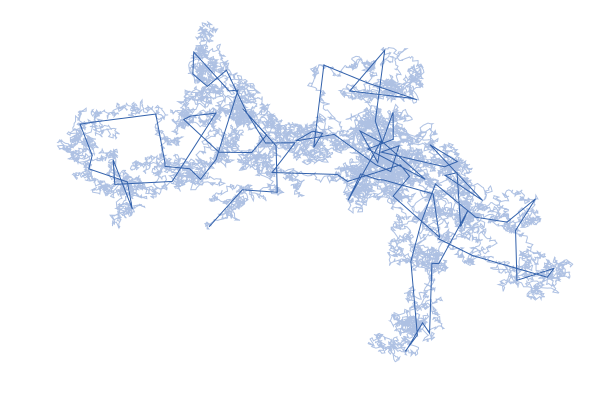

In [215]:
N = 20000

X = zeros(N)
Y = zeros(N)
for i in 2:N
    X[i] = X[i-1] + randn()
    Y[i] = Y[i-1] + randn()
end

U = []
V = []
for i in 1:200:N
   push!(U, X[i]) 
   push!(V, Y[i]) 
end

plot(X, Y,  label="", lc="#AEC1E3", frame=:none)
plot!(U, V, label="", lc="#3261AB", frame=:none)

savefig("fractal.svg")
plot!()

### Bachelier(1900)

一応, [Bachelier(1900)](https://doi.org/10.24033/asens.476)には目を通したが, Brown運動の原理の解明には全く寄与していないと思われる.

> 確率微分方程式の研究の源流は, 経済学の分野ではLouis Bachelierが1900年に執筆した学位論文（参考文献[50]）にあるとされ, 物理学の分野では1905年にAlbert Einsteinが発表した論文（参考文献[64]）にあるとされている.<br>―　[兼清泰明『確率微分方程式とその応用』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007781) p.1

### Einstein(1905)

Einsteinの三大業績の一つ. 「奇跡の年」の2本目の論文である[Einstein(1905)](https://doi.org/10.1002/andp.19053220806)では, 粒子の<b>平均二乗変位</b>からアボガドロ定数$N$を算出する理論を発表した. Brownが取りあげた運動と同じものかは断定できなかったと序文に書いてあり, とても謙虚である. Einsteinは論文の最後の式

> $$N = \frac{t}{{\lambda_x}^2} \cdot \frac{RT}{3\pi kP}$$

から, 時間間隔$t$での平均二乗変位${\lambda_x}^2$を実験的に求めれば, アボガドロ定数$N$を算出できることを示した. Einsteinは導出の過程で拡散方程式とその根平均二乗変位（RMSD）

> $$\frac{\partial f}{\partial t}=D\frac{\partial^2 f}{\partial x^2}$$

> $$\lambda_x = \sqrt{2Dt}$$

を用いている. 詳しい式の導出は [米沢登美子『物理学 One Point - 27 ブラウン運動』(共立出版, 1986)](https://www.kyoritsu-pub.co.jp/bookdetail/9784320032361) p.56に載っている.
<!-- 浸透圧の式とStokesの式などを連立して力の釣り合いを考えて導出した

> $$D = \frac{RT}{N}\frac{1}{6\pi kP}$$

と拡散方程式から導出した根平均二乗変位（RMSD）

> $$\lambda_x = \sqrt{2Dt}$$

を連立して

> $$\lambda_x = \sqrt{t} \cdot \sqrt{\frac{RT}{N}\frac{1}{3\pi kP}}$$

を得て, これを変形することでアボガドロ定数$N$が得られる. -->

### Smoluchowski(1906)

Einsteinとは別の方法でBrown運動を説明したのが[Smoluchowski(1906)](https://doi.org/10.1002/andp.19063261405)である(その旨がp.768に明記してある). Smoluchowski自ら指摘している通り, EinsteinとSmoluchowskiの結果はよく似ているが, 定数倍(具体的には$\sqrt{27/64}\approx0.65$倍)だけ異なる. Einsteinの根平均二乗変位が

> $$\lambda_x = \sqrt{t} \cdot \sqrt{\frac{RT}{N}\frac{1}{3\pi kP}}$$

であり, Smoluchowskiの根平均二乗変位が

> $$\Lambda=\frac{8}{9\sqrt{\pi}} \frac{c\sqrt{m}}{\sqrt{\mu R}}$$

である. この2式はあまり似ているように見えない. p.768の脚注には$\lambda_x=\frac{\Lambda}{\sqrt{3}}, \frac{RT}{N}=\frac{mc^2}{3}, k=\mu, P=R$と置き換えればよい旨が書いてあるので, それに従って変形すると以下を得る. 確かに$\sqrt{27/64}\approx0.65$倍ほど異なるようだ. それよりも$\sqrt{t}$はどうしたのだろうか.

$$
\begin{aligned}
    \Lambda &= \frac{8}{9\sqrt{\pi}} \frac{c\sqrt{m}}{\sqrt{\mu R}}\\
    \Lambda &= \frac{8}{9\sqrt{\pi}} \sqrt{3} \frac{c\sqrt{m}}{\sqrt{3}} \frac{1}{\sqrt{\mu R}}\\
    \Lambda &= \frac{8}{9\sqrt{\pi}} \sqrt{3} \sqrt{\frac{mc^2}{3}} \frac{1}{\sqrt{\mu R}}\\
    \sqrt{3} \lambda_x &=  \frac{8}{9\sqrt{\pi}} \sqrt{3} \sqrt{\frac{RT}{N}} \frac{1}{\sqrt{kP}}\\
    \lambda_x &= \frac{8}{3\sqrt{3}} \sqrt{\frac{RT}{N}\frac{1}{3\pi kP}}\\
    \lambda_x &= \sqrt{\frac{64}{27}} \sqrt{\frac{RT}{N}\frac{1}{3\pi kP}}\\
\end{aligned}
$$

### Perrin(1908)

[Perrin(1908)](https://gallica.bnf.fr/ark:/12148/bpt6k3100t/f969.item)では$N_\mathrm{A}=6.7\times10^{23}$が得られたと最終行に書いてある.

> ぺランは, 一連の実験により,（最初の結果を公表したのは1908年の論文）それまで誰にも達成できなかった正確さで, アインシュタインの予測のほとんどすべてを裏付けた.<br>―　[ジョン・スタチェル編, 青木薫訳『アインシュタイン論文選「奇跡の年」の5論文』(ちくま学芸
文庫, 2011)](https://www.chikumashobo.co.jp/product/9784480094032/) p.201

### Perrinはどれくらい正しかったのか？

<!-- [Perrin(1909)](https://hal.archives-ouvertes.fr/jpa-00242381)では$N_A=7.05\times10^{23}$を報告しており, 別の測定法による3つの先行研究 ($6.51022\times 10^{23}$, $7.06\times 10^{23}$, $7.11022\times 10^{23}$.) と比較して, Brown運動が分子運動に由来することを最後に結論付けている.  -->

2021年現在の最新のアボガドロ定数は[2018年CODATA推奨値](https://physics.nist.gov/cuu/Constants/index.html)

$$
N_\mathrm{A} = 6.022~140~76 \times 10^{23} \mathrm{mol}^{-1}
$$

である(次回の改定は2022年で, 2023年に発表される). これと比較すると, Perrinの実験値はかなり過大評価しているように思われる. [Becker(2001)](https://doi.org/10.1088/0034-4885/64/12/206)によると, Perrin(1908)以前からアボガドロ定数は高く見積もられる傾向があったようで, 当時としてはそこまでおかしな値ではなかったようである. Perrinが[1926年にノーベル物理学賞を授賞](https://www.nobelprize.org/prizes/physics/1926/ceremony-speech/)する頃には現在の最新値にかなり近づいていたことがわかる. 後に説明するが, Brown運動から拡散係数$D$を求めると過小評価してしまうはずであり, アボガドロ定数$N_\mathrm{A}$が過大評価されている点には安心感がある. なお, 下図のエラーバーの扱い方には自信がないので各自[Becker(2001)](https://doi.org/10.1088/0034-4885/64/12/206)を参照されたい. 1924年までの測定方法は原子や分子の運動に基づく測定方法であったため, アボガドロ定数$N_\mathrm{A}$を過大評価したのだと思われる.

In [195]:
Becker2001 = [
38 1865 "Loschmidt" "Mean free path" 72 1*10^(-0);
37 1873 "van der Waals" "Kin. gas theory" 11 5*10^(-1);
36 1890 "Rontgen" "Atom. films on water" 7 1*10^(-0);
35 1890 "Rayleigh" "Atom. films on water" 6.08 1*10^(-2);
34 1901 "Planck" "R/k" 6.16 1*10^(-2);
33 1903 "Wilson" "Oil drop method" 9.3 1*10^(0);
32 1904 "Thomson" "Oil drop method" 8.7 1*10^(0);
31 1908 "Einstein" "Diffusion theory" 6 1*10^(0);
30 1908 "Perrin" "Brownian movement" 6.7 3*10^(-1);
29 1909 "Rutherford" "α-particle theory" 6.16 6*10^(-2);
28 1914 "Fletcher" "Brownian movement" 6.0 2*10^(-1);
27 1914 "Nordlund" "Diffusion in fluids" 5.91 1*10^(-2);
26 1915 "Westgreen" "Diffusion in fluids" 6.06 2*10^(-1);
25 1917 "Millikan" "Oil drop method" 6.064 6*10^(-3);
24 1923 "Shaxby" "Diffusion in fluids" 5.9 0;
23 1924 "du Nouy" "Thin films" 6.004 8*10^(-3);
22 1929 "Birge" "X-ray diffraction" 6.0644 6*10^(-3);
21 1931 "Bearden" "X-ray gratings/plane" 6.019 3*10^(-3);
20 1941 "Birge" "Calcite, NaCl, KCl,..." 6.02283 1*10^(-4);
19 1945 "Birge" "Diamond, LiF" 6.02338 2*10^(-4);
18 1948 "DuMond" "X-gratings/concave" 6.0232 1*10^(-4);
17 1949 "Straumanis" "Calcite crystals" 6.02403 3*10^(-4);
16 1951 "DuMond" "" 6.02544 1*10^(-4);
15 1965 "Bearden" "XRCD, Si" 6.022088 2*10^(-5);
14 1965 "Cohen" "LS. adjustment" 6.02252 9*10^(-5);
13 1973 "Cohen" "LS. adjustment" 6.022045 3*10^(-5);
12 1974 "Deslattes" "XRCD, Si" 6.0220943 1*10^(-6);
11 1987 "Deslattes" "XRCD" 6.022134 1*10^(-6);
10 1987 "Cohen" "LS. adjustment" 6.0221367 6*10^(-7);
9 1992 "Seyfried" "XRCD" 6.0221363 1*10^(-6);
8 1994 "Basile" "XRCD" 6.0221379 4*10^(-7);
7 1995 "De Bievre" "XRCD" 6.0221365 6*10^(-7);
6 1999 "Fujii" "XRCD" 6.0221550 3*10^(-7);
5 2001 "De Bievre" "XRCD" 6.0221339 4*10^(-7);
]
println(Becker2001[9,:]...)

301908PerrinBrownian movement6.70.30000000000000004


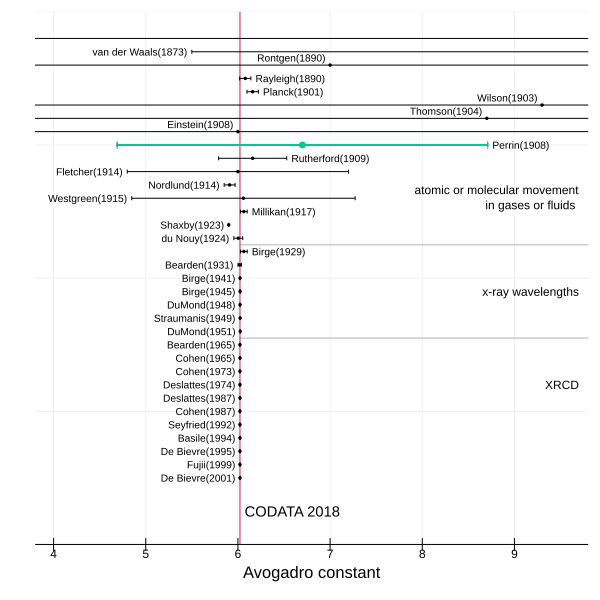

In [196]:
NA = 6.02214076
plot(xlims=(3.8,9.8), ylims=(0, 40), framestyle=:origin, size=(600,600), xlabel="Avogadro constant")
plot!([NA, NA], [0,40], label="", lc="#C32147")
scatter!(Becker2001[:,5], Becker2001[:,1], xerrors=Becker2001[:,5].*Becker2001[:,6] , label="", msc="#000000", mc="#000000", msw=1, ms=1)
scatter!([Becker2001[9,5]], [Becker2001[9,1]], xerrors=[Becker2001[9,5]*Becker2001[9,6]] , label="", msc="#00C896", mc="#00C896", msw=2, ms=2)
plot!(NA:0.5:10.5, x->22.5, label="", lc="#000000", alpha=0.3)
plot!(NA:0.5:10.5, x->15.5, label="", lc="#000000", alpha=0.3)
plot!(annotations=(9.7, 26, ("atomic or molecular movement\\n in gases or fluids", 8, 0.0, :right)))
plot!(annotations=(9.7, 19, ("x-ray wavelengths", 8, 0.0, :right)))
plot!(annotations=(9.7, 12, ("XRCD", 8, 0.0, :right)))
plot!(annotations=(NA+0.05, 2.5, ("CODATA 2018", 10, 0.0, :left)))

for i in 1:length(Becker2001[:,2])
    if i in [4,5,9,10,14,17]
        plot!(annotations=(Becker2001[i,5]+Becker2001[i,5].*Becker2001[i,6]+0.05, Becker2001[i,1], ("$(Becker2001[i,3])($(Becker2001[i,2]))", 7, 0.0, :left)))
    elseif i in [3,6,7,8]
        plot!(annotations=(Becker2001[i,5]-0.05, Becker2001[i,1]+0.55, ("$(Becker2001[i,3])($(Becker2001[i,2]))", 7, 0.0, :right)))
    else
        plot!(annotations=(Becker2001[i,5]-Becker2001[i,5].*Becker2001[i,6]-0.05, Becker2001[i,1], ("$(Becker2001[i,3])($(Becker2001[i,2]))", 7, 0.0, :right)))
    end
end

plot!()

savefig("perrin.svg")
plot!()

### Langein(1908)

[Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien) はEinsteinとSmoluchowskiの論文を元に, 粒子が粘性抵抗とランダムな力(揺動力)を受けるときの運動方程式として<b>Langevin方程式</b>

> $$m\frac{\mathrm{d}^2 x}{\mathrm{d}t^2} = -6\pi\mu a \frac{\mathrm{d} x}{\mathrm{d}t} + X \tag{3}$$

を提案した. また, Langevin方程式から平均二乗変位を導出し, Einsteinの論文と同じ結果を得た.

> $$\bar{\Delta_x^2} = \bar{x^2}-\bar{x^2_0} = \frac{RT}{N}\frac{1}{3\pi\mu a}\tau \tag{10}$$

### Langevin(1908)以降の発展

以降はLangevin方程式をはじめとする確率微分方程式の歴史へと繋がっていく. [伊藤清先生の数学](https://www.mathsoc.jp/publication/tushin/2004/2004watanabe.pdf)によれば, WienerはPerrinの著書に触発されてWiener過程の研究を始めたとのことである.

### まとめ

- [Brown(1828)](https://doi.org/10.1080/14786442808674769)はBrown運動が<b>生命現象である可能性を否定</b>した.
- [Einstein(1905)](https://doi.org/10.1002/andp.19053220806)は粒子の<b>平均二乗変位</b>からアボガドロ定数を算出する理論を提唱した.
- [Perrin(1908)](https://gallica.bnf.fr/ark:/12148/bpt6k3100t/f972.item)で$N_A=6.7\times10^{23}$が得られ, これを以て原子・分子の実在性が受け入れられた.
- [Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien) はノイズを含む運動方程式として<b>Langevin方程式</b>を提案し, Einsteinと同じ結果を導いた.

拡散方程式とLangevin方程式のMSDは異なる, という認識に基づけば, [Einstein(1905)](https://doi.org/10.1002/andp.19053220806)と[Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)が同じ結論にたどり着いたことは非常に面白い！

## 第２部

確率過程の概念, Eular-Maruyama法による種々の確率微分方程式の数値解法について, Julia言語での実装例を交えて解説する. 得られた数値解はPlots.jlを用いて可視化し, Fokker-Planck方程式の解析解と比較する.

### 確率過程

<strong>確率過程</strong>（stochastic process）とは, 時間に依存して変化する<strong>確率変数</strong>（stochastic variable）のことである. 時間が$t=1,2,3,4,\cdots$のように離散的な値をとる確率過程を<strong>離散確率過程</strong>（discrete stochastic process）といい,  連続的な値をとる確率過程を<strong>連続確率過程</strong>（containuous stochastic process）という.

いい加減な定義ではあるものの, 確率変数が$X:\Omega\rightarrow\mathbb{R^n}$であり, 確率過程が$X:\Omega\times T\rightarrow\mathbb{R^n}$であるから, 概ね正しいと思われる.

このノートでは, 離散確率過程の例としてランダムウォークモデルを, 連続確率過程の例としてWiener過程(数学のBrown運動), ドラフト項のあるWiener過程, Ornstein–Uhlenbeck過程などのを取り上げる. これらの連続確率過程は<strong>確率微分方程式</strong>（Stochastic Differential Equation, SDE）の解でもある.

### ランダムウォークモデル

よく勘違いされるが, ランダムウォークモデルとBrown運動は別のモデルであり, 前者は離散確率過程で後者は連続確率過程である. ここでは, 離散確率過程の例としてランダムウォークモデルを取り上げる. 先に補足しておくと, ランダムウォークモデルの連続極限として拡散方程式を導出できる. 拡散方程式の導出や他の離散確率過程の例は[こちらのノート](https://gist.github.com/ohno/8645edfe0a12c95b87f57ab7191fd966)にまとめてある. 


コインを投げて表なら$R_i=+1$, 裏なら$R_i=-1$を得点とする. コインを$i$回目に投げたときの合計得点を$X_i=\sum_{j=1}^{i}R_j$とする. $i=1$のとき, $X_i=+1,-1$のどちらかだが, $i=2$の時は$X_i=+2,0,-2$のどれかの値を取りうる. つまり, 確率分布が時間$i$に依存する. なお, $R_i$の確率分布は時間に依らない.

以下に, 横軸を投げた回数$i$とし, 縦軸をそれぞれ得点$R_i$と合計得点数$X_i$としたグラフを描写した.

R = [1, -1, -1, 1, 1, 1, 1, -1, 1, 1, -1, 1, 1, 1, 1, -1, 1, -1, -1, 1, -1, -1, 1, 1, 1, -1, -1, -1, -1, -1]
X = [1, 0, -1, 0, 1, 2, 3, 2, 3, 4, 3, 4, 5, 6, 7, 6, 7, 6, 5, 6, 5, 4, 5, 6, 7, 6, 5, 4, 3, 2]


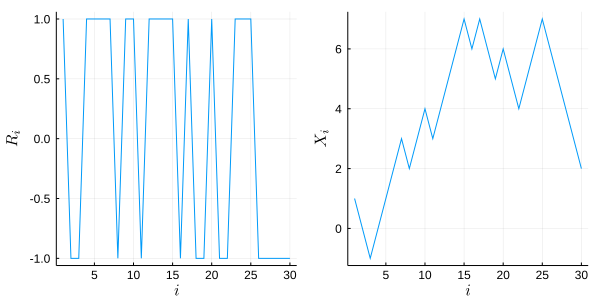

In [187]:
step = 30

R = Int.((floor.(rand(step)*2) .- 0.5)*2)
X = zeros(Int64, step)

X[1] = R[1]
for i in 2:step
    X[i] = X[i-1] + R[i]
end

println("R = ", R)
println("X = ", X)

plot(
    plot(R, xlabel="\$i\$", ylabel="\$R_i\$", label=""),
    plot(X, xlabel="\$i\$", ylabel="\$X_i\$", label=""),
    size=(600, 300)
)

savefig("randomwalk.svg")
plot!()

また, 500人でランダムウォーク大会を行った場合のグラフと, それぞれの$i$について人数を数えたヒストグラムを示した. 十分に試行回数が増えればガウス分布に近づくはずである.

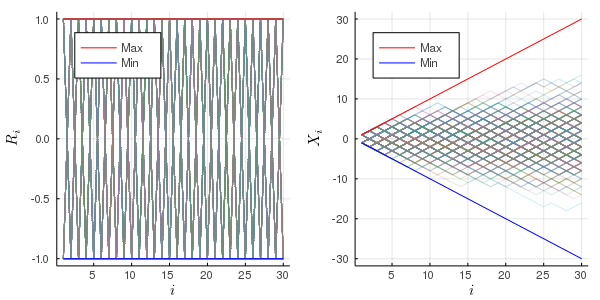

In [222]:
step = 30
member = 500

R = (floor.(rand(step, member)*2) .- 0.5)*2
X = zeros(step, member)

X[1,:] = R[1,:]
for i in 2:step
    X[i,:] = X[i-1,:] + R[i,:]
end

plt1 = plot(R, alpha=0.2, label="", xlabel="\$i\$", ylabel="\$R_i\$", legend=:topleft) 
plot!(plt1, 1:step, i->1, color=:red, label="Max ") 
plot!(plt1, 1:step, i->-1, color=:blue, label="Min")

plt2 = plot(X, alpha=0.2, label="", xlabel="\$i\$", ylabel="\$X_i\$", legend=:topleft) 
plot!(plt2, 1:step, i->i, color=:red, label="Max ") 
plot!(plt2, 1:step, i->-i, color=:blue, label="Min")

plot(plt1, plt2, size=(600, 300), fmt=:png)

savefig("randomwalks.png")
plot!()

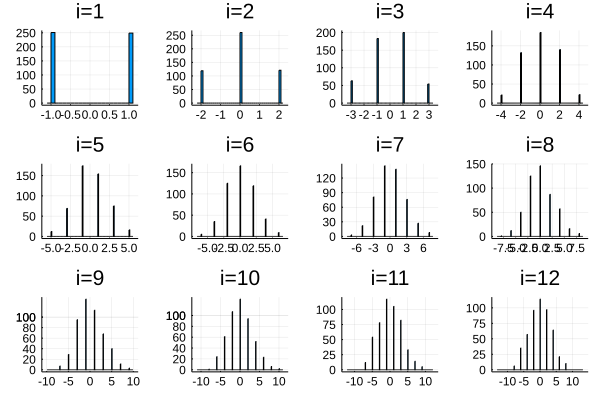

In [185]:
plt = []
for i in 1:12
    push!(plt, histogram(X[i,:], title="i=$i", bins=range(-1.1*i,1.1*i,step=0.1), label=""))
end

plot(plt...)

savefig("randomwalks_histogram.svg")
plot!()

### 白色雑音とWiener過程

正確ではないが, 白色雑音$R(t)$はWiener過程$W(t)$の時間微分のようなものであり, ちょうどコインを投げた回数$i$に対する, 得点$R_i$と合計得点数$X_i$の関係によく似たものである.

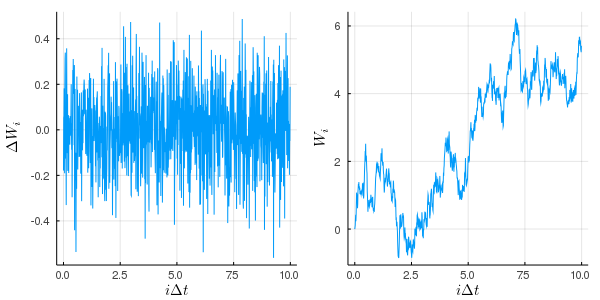

In [223]:
step = 1000
Du = 1.5
dt = 0.01

T = [dt*i for i in 0:step-1]
W = zeros(step)
dW = sqrt(2*Du*dt)*randn(step)

for i in 2:step
    W[i] = W[i-1] + dW[i]
end

plot(
    plot(T, dW, xlabel="\$i\\Delta t\$", ylabel="\$\\Delta W_i\$", label=""),
    plot(T, W, xlabel="\$i\\Delta t\$", ylabel="\$W_i\$", label=""),
    size=(600, 300),
    fmt=:png
)

savefig("wiener_process.svg")
plot!()

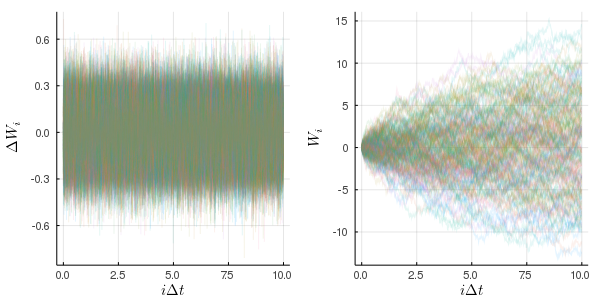

In [225]:
step = 1000
member = 200
Du = 1.5
dt = 0.01

T = [dt*i for i in 0:step-1]
W = zeros(step, member)
dW = sqrt(2*Du*dt)*randn(step, member)

for i in 2:step
    W[i,:] = W[i-1,:] + dW[i,:]
end

plot(
    plot(T, dW, xlabel="\$i\\Delta t\$", ylabel="\$\\Delta W_i\$", label="", lw=1, la=0.1, lc=[1 2 3 4 5 6 7 8 9 10]),
    plot(T, W, xlabel="\$i\\Delta t\$", ylabel="\$W_i\$", label="", lw=1, la=0.1, lc=[1 2 3 4 5 6 7 8 9 10]),
    size=(600, 300),
    fmt=:png
)

savefig("wiener_processes.png")
plot!()

Langevin方程式を扱う物理学の文脈では, 白色雑音は<strong>揺動力</strong>として導入され, その性質を出発点とした相関関数の計算によって議論が進められる. 一方, 数学では白色雑音の扱いを避けて, Wiener過程を議論の出発点に採用することが多いようである(理由は後述する).

このノートでも, 白色雑音の性質は不要なので使わない. また, Wiener過程についても$W(t)-W(s) \sim N(0,2D_u(t-s))$という性質を使うのみなので, どちらも簡単な紹介に留める. 白色雑音$R(t)$とWiener過程$W(t)$はそれぞれ次のような性質を満たすものとして定義されることが多い.

$$
\begin{aligned}
    \langle R(t) \rangle &= 0\\
    \langle R(t_1)R(t_2) \rangle &= 2D_u \delta(t_1-t_2)\\
    \\
    \langle W(t) \rangle &= 0\\
    \langle W(t_1)W(t_2) \rangle &= 2D_u {\rm  min}(t_1,t_2)\\
    W(t) &\sim N(0,t)
\end{aligned}
$$

なお, $X \sim N(\mu,\sigma^2)$は確率変数$X$が平均$\mu$, 分散$\sigma^2$の正規分布に従うという意味である. Wiener過程$W(t)$の最も重要な性質は

$$
    W(t)-W(s) \sim N(0,2D_u(t-s))
$$

である. [兼清(2017) p.103](#参考文献)ではこの性質をWiener過程$W(t)$の定義に含めているが, [三井(2004) p.139](#参考文献)では定理として導出している. いずれにせよ, この性質によって, Wiener過程$W(t)$を時間間隔$\Delta t$で分割するとき, $\Delta t$あたりの変化量$\Delta W$が正規分布$N(0,2D_u\Delta t)$に従う疑似乱数として計算できる. ここで述べていることはEular-Maruyama法の特殊例であるから, 厳密な議論を必要とする読者はIto-Taylor展開によるEular-Maruyama法の導出について参照されたい.

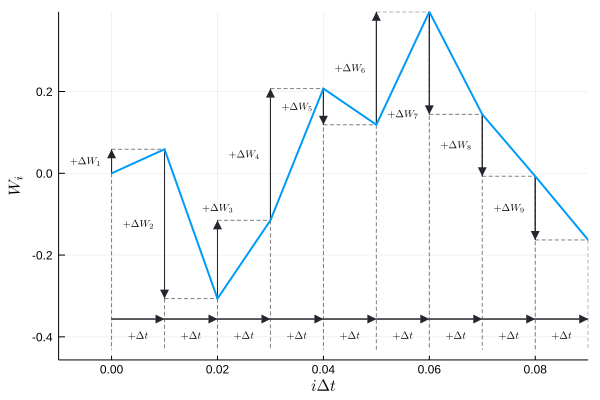

In [191]:
step = 10
dt = 0.01
# Du = 1.5

# T = [dt*i for i in 0:step-1]
# W = zeros(step)
# dW = sqrt(2*Du*dt)*randn(step)

# for i in 2:step
#     W[i] = W[i-1] + dW[i]
# end

# println("T = $T")
# println("W = $W")

T = [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09]
W = [0.0, 0.058763734934133255, -0.3064429609662668, -0.1150187791553188, 0.20713134172141554, 0.118633670957381, 0.39487790707242687, 0.1440882274695458, -0.007232462279190721, -0.16312644695165768]

plot(xlims=(-dt,maximum(T)), ylims=(minimum(W)-0.15, maximum(W)))

for i in 1:step
    plot!([T[i],T[i]], [W[i],minimum(W)-0.125], label="", ls=:dash, lc="#000000", alpha=0.5)
end

for i in 1:step-1
    plot!([T[i],T[i]], [W[i],W[i+1]], label="", lc="#24292E", arrow=(:closed, 2.0))
    plot!([T[i],T[i+1]], [minimum(W)-0.05,minimum(W)-0.05], label="", lc="#24292E", arrow=(:closed, 2.0))
    plot!([T[i],T[i+1]], [W[i+1],W[i+1]], label="", ls=:dash, lc="#000000", alpha=0.5)
    plot!(annotations=((T[i]+T[i+1])/2, minimum(W)-0.09, ("\$+\\Delta t\$", 7, 0.0, :center)))
    if !(i in [3,7])
        plot!(annotations=(T[i]-dt/2, (W[i]+W[i+1])/2, ("\$+\\Delta W_$i\$", 7, 0.0, :center)))
    end
end

i = 3
plot!(annotations=(T[i], W[i+1]+0.02, ("\$+\\Delta W_$i\$", 7, 0.0, :bottom)))
i = 7
plot!(annotations=(T[i]-dt/2, W[i+1], ("\$+\\Delta W_$i\$", 7, 0.0, :center)))

plot!(T, W, xlabel="\$i\\Delta t\$", ylabel="\$W_i\$", label="", lc=1, lw=2)

savefig("wiener_process_description.svg")
plot!()

### 白色雑音を取り巻く問題

厳密には, <strong>白色雑音</strong>$R(t)$は[確率超過程](https://www.math.is.tohoku.ac.jp/~obata/research/file/2008-IIAS-report.pdf)というものに分類され, 連続確率過程(そもそも確率過程)ではない. 一方, <strong>Wiener過程</strong>$W(t)$は連続確率過程の例である.

白色雑音$R(t)$はWiener過程$W(t)$の形式的な微分に相当する確率過程であるから, ちょうど双六でいうところのサイコロの目$R_i$と進んだマスの数$X_i$や, ランダムウォークモデルで言うところのコインの裏表$R_i$と進んだマスの数$X_i$と似たような関係である. ただし, 以下の点に注意しよう.

> 結論から言うと, このような白色雑音は, 数学的には確率過程のカテゴリーに入れて議論することができない
<br>―　[兼清泰明『確率微分方程式とその応用』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007781) p.100

> 白色雑音を数学的に厳密に取り扱うには, 確率超過程と呼ばれる概念を導入しなければならない
<br>―　[兼清泰明『確率微分方程式とその応用』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007781) p.100

> 白色雑音を数学的な議論の出発点とするのは適切ではない.
<br>―　[堀淳一『ランジュバン方程式』(岩波書店, 2015)](https://www.iwanami.co.jp/book/b266718.html) p.53

> 2乗平均微分可能性の判定定理によって, $W(t)$は2乗平均微分可能でなく, $W(t)$の微分過程として白色雑音$P(t)$を定義することはできない
<br>―　[堀淳一『ランジュバン方程式』(岩波書店, 2015)](https://www.iwanami.co.jp/book/b266718.html) p.54

> 連続時間過程としての白色雑音は厳密には存在しないため, もちろんそのグラフを正確に図示することはできない.
<br>―　[兼清泰明『確率微分方程式とその応用』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007781) p.102

### 確率微分方程式

微分方程式の解は微分可能でなければならない. Brown運動の軌道は明らかに微分可能ではないから, Brown運動の運動方程式(微分方程式)を考えるのはおかしい. そのようなわけで, Langevin方程式は通常の微分方程式としては解釈できない. ではどのように解釈すればよいかというと, 確率積分を含む方程式の別表記と考えるのである. というわけで, SDEは微分方程式というよりはむしろ積分方程式である. 確率微分方程式には確率積分としてIto積分を採用する立場とStratonovich積分を採用する立場の2つの立場があるが, このノートでは全てIto積分を採用する.

>(3.2.3)の第2の積分をIto積分と解釈したとき, これらの方程式を<strong>ItoのLangevin方程式</strong>あるいは<strong>Itoの方程式</strong>という.<br>　―　[堀淳一『ランジュバン方程式』(岩波書店, 2015)](https://www.iwanami.co.jp/book/b266718.html) p.61

$$
\begin{aligned}
    \frac{{\rm d}X(t)}{{\rm d}t} = f(X(t),t) + g(X(t),t)R(t) &&(3.2.1)\\
    \mathrm{d}X(t) = f(X(t),t)\mathrm{d}t + g(X(t),t)\mathrm{d}W(t) &&(3.2.2)\\
    X(t)-X(t_0) = \int_{t_0}^{t_1} f(X(s),s){\rm d}s + \int_{t_0}^{t_1} g(X(s),s){\rm d}W(s) &&(3.2.3)
\end{aligned}
$$

(3.2.3)の右辺の第2項の積分は, Ito積分を採用することで決まった値を持つようになり,(3.2.3)が意味を持つようになる.  (3.2.1)と(3.2.2)は形式的に$\mathrm{d}W(t)=R(t)\mathrm{d}t$を認めたときの(3.2.3)の別表記であり, 同じ意味を持つものとする. これによって, (3.2.1)のような通常の微分方程式と同じ表記が使えるようになる. 運動方程式として考えるのであれば, やはり(3.2.1)の表記が好ましいだろう.

Ito方程式(3.2.1)～(3.2.3)をBrown運動の運動方程式(Langevin方程式)として解釈しようとすると, $X(t)$は速度だと思わなくてはいけないので$V(t)$の記号に変えた方がよい. また, $f(X(t),t)=-\gamma X(t), g(X(t),t)=1$の時が狭義でのLangevin方程式なので, かなり一般化されている. そのため, 「一般化Langevin方程式」とでも呼びたいところだが, これはまた別の方程式を指す名称なので紛らわしい. (3.2.1)～(3.2.3)をItoのLangevin方程式と呼ぶのは誤解を招くであろうから, このノートでは単にIto方程式と呼ぶ.

### Fokker-Planck方程式

> 確率論と解析学の間には実り多い相互関係がある. その研究は少なくともKolmogorov(1931)にさかのぼる. (中略) 楕円型, 放物型偏微分方程式の多くの問題の解は確率汎関数の期待値として表現することができる.<br>― L.カラザス, S.E.シュレーブ著, 渡邉壽夫訳『ブラウン運動と確率積分』(丸善出版, 2012) 第4章 4.1序論

このノートでは, 上記のEular-Maruyama法による数値解の妥当性をFokker-Planck方程式によって評価する. Ito方程式

$$
    \frac{{\rm d}X(t)}{{\rm d}t} = f(X(t),t) + g(X(t),t)R(t)
$$

の解$X(t)$の確率密度関数$P(x,t)$が従う偏微分方程式として<strong>Fokker-Planck方程式</strong>

$$
    \frac{\partial P(x,t)}{\partial t} = \frac{\partial^2 [D_u (g(x,t))^2 P(x,t)]}{\partial x^2}-\frac{\partial [f(x,t)P(x,t)]}{\partial x}
$$

が知られている. 以下に具体例をまとめる. 今回は$D=D_u$としてよい.

|条件|Ito方程式|Fokker-Planck方程式|
|:---:|:---:|:---:|
|$$f(X(t),t)=0, g(X(t),t)=1$$|$${\frac{{\rm d}X(t)}{{\rm d}t}=R(t)}$$ <br> Wiener過程|$$\frac{\partial P(x,t)}{\partial t}=D\frac{\partial^2 P(x,t)}{\partial x^2}$$ <br> 拡散方程式|
|$$f(X(t),t)=c, g(X(t),t)=1$$|$${\frac{{\rm d}X(t)}{{\rm d}t}=c + R(t)}$$ <br> ドリフト項のあるWiener過程|$$\frac{\partial P(x,t)}{\partial t}=D\frac{\partial^2 P(x,t)}{\partial x^2}-c\frac{\partial P(x,t)}{\partial x}$$ <br> 移流拡散方程式|
|$$f(X(t),t)=-\gamma X(t), g(X(t),t)=1$$|$${\frac{{\rm d}X(t)}{{\rm d}t}=-\gamma X(t) + R(t)}$$ <br> Ornstein–Uhlenbeck過程|$$\frac{\partial P(x,t)}{\partial t}=D\frac{\partial^2 P(x,t)}{\partial x^2}-\frac{\partial (-\gamma XP(x,t))}{\partial x}$$ <br> 名前なし|

初期条件$P(x,0) = \delta(x-x_0)$, 境界条件$P(\pm\infty,t)=0$のときの解はそれぞれ以下の通りである.

$$
\begin{aligned}
    P(x,t) = \frac{1}{\sqrt{4\pi Dt}} \exp \left( -\frac{(x-x_0)^2}{4Dt} \right) \\
    P(x,t) = \frac{1}{\sqrt{4\pi Dt}} \exp \left( -\frac{(x-x_0-ct)^2}{4Dt} \right) \\
    P(x,t) = \sqrt{\frac{\gamma}{2\pi D(1-e^{-2\gamma t})}} \exp \left( -\frac{\gamma(x-x_0 e^{-\gamma t})^2}{2D(1-e^{-2\gamma t})} \right)
\end{aligned}
$$

### 揺動力の強さ$D_u$と拡散係数$D$

後に説明するが, 拡散方程式($f(X(t),t)=0, g(X(t),t)=1$のIto方程式)とLangevin方程式の導く平均二乗変位$\langle|X(t)|^2\rangle$は異なるものである.  拡散係数を求める際によく目にする$\langle|X(t)|^2\rangle = 2nDt$とLangevin方程式から導かれる$\langle|\boldsymbol{X}(t)|^2\rangle = 2n\frac{D_u m}{\gamma^3} \left(\frac{\gamma}{m} t+e^{-\frac{\gamma}{m} t}-1 \right)$は, 特定の条件下でのみEinsteinの関係式

$$
    D = \frac{D_u}{\gamma^2} = \frac{k_\mathrm{B}T}{\gamma}
$$

で結ばれる. Fokker-Planck方程式の説明だけを見ると揺動力の強さ$D_u$と拡散係数$D$は一致するように見えるが, Langrvin方程式を見据えると, 揺動力の強さ$D_u$と拡散係数$D$は明確に区別することが教育的であると思われる.

### Eular-Maruyama法

Eular-Maruyama法は確率初期値問題

$$
    \frac{{\rm d}X(t)}{{\rm d}t} = f(X(t),t) + g(X(t),t)R(t),\\ t\in[t_0,T], X(t_0)=X_0
$$

を次のように離散化する方法である.

$$
    X_{i+1} \simeq X_i + f(X_i, t)\Delta t + g(X_i, t)\Delta W_i
$$

このとき, $\Delta t$は時間刻み幅で, 粗い計算なら0.1などを選ぶ. $\Delta W_i$は正規分布$N(0,2D_u\Delta t)$に従う疑似乱数である. Eular-Maruyama法はEular法の一般化であり, $g(X(t),t)=0$の場合はEular法と一致する. 詳細な説明および高次の方法については[三井(2004)](#参考文献), [兼清(2017)](#参考文献), [Ogawa(2001)](https://doi.org/10.11429/sugaku1947.53.34), または[こちらの記事]( https://qiita.com/kaityo256/items/6e9957b0739f5a3690f2)を参照されたい.

### 数値計算：Wiener過程

Wiener過程がGauss分布$N(0,t)$に従うことは定義に含まれているのだが, Ito方程式の特殊化としてWiener過程を考えることで, Fokker-Planck方程式の議論から拡散方程式との関係を理解できる.
Wiener過程はIto方程式の$f(X(t),t)=0, g(X(t),t)=1$の場合である.

$$
    \frac{{\rm d}X(t)}{{\rm d}t} = R(t)\\
    {\rm d}X(t) = {\rm d}W(t)\\
    X(t)-X(t_0) = \int_{t_0}^{t_1} {\rm d}W(s)
$$

Eular-Maruyama法による離散化は次式である.

$$
    X_{i+1} \simeq X_i + \Delta W_i
$$

対応するFokker-Planck方程式は次式である. これは拡散方程式と呼ばれる.

$$
    \frac{\partial P(x,t)}{\partial t}=D\frac{\partial^2 P(x,t)}{\partial x^2}
$$

対応する初期条件はそれぞれ

$$
    X(0) = X_0\\
    P(x,0) = \delta(x-x_0)
$$

であり, 境界条件$P(\pm\infty,t)=0$のときの解は次式である.

$$
    P(x,t) = \frac{1}{\sqrt{4\pi Dt}} \exp \left( -\frac{(x-x_0)^2}{4Dt} \right)
$$

┌ Info: Saved animation to 
│   fn = C:\Users\Shuhei\Desktop\GitHub\butsudoi2021\document\SDE_1.gif
└ @ Plots C:\Users\Shuhei\.julia\packages\Plots\qZHsp\src\animation.jl:98


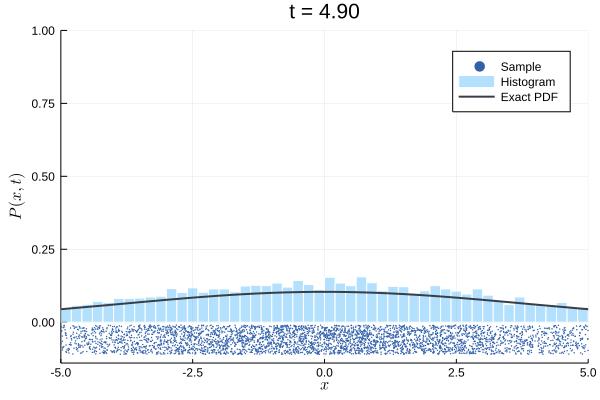

In [211]:
function SDE()    
    # パラメータ：
    N = 5000        # 粒子数
    dt = 0.1        # 時間刻み幅
    step = 50       # 時間ステップ
    name = "SDE_1"  # ファイル名
    x0 = 0          # 初期位置
    Du = 1.5        # 揺動力の強さ(一般には拡散係数Dと一致しない)
    D  = Du         # 厳密解の計算で使う拡散係数D
    f(x,t) = 0      # 外力のようなもの
    g(x,t) = 1      # 今回は1
    exact(x) = exp(-(x-x0)^2/(4*D*t)) / sqrt(4*D*pi*t)

    # 初期値：
    t = 0.0
    X = fill(x0, N)
    Y = [-0.01-0.1*i/N for i in 1:N] # 描写のときのサンプルのy座標. 計算には関係ない
    anim = Animation()

    for i in 1:step
        # 描写：
        plt = scatter(X, Y, xlims=(-5,5), ms=1, msw=0, mc="#3261AB", label="Sample", xlabel="\$x\$", ylabel="\$P(x,t)\$")
        histogram!(plt, X, bins=range(-5,5,step=0.2), ylims=(-0.14,1.0), normed=true, label="Histogram", fa=0.3, fc=1, lc="#FFFFFF")
        plot!(plt, exact, lw=2, lc="#393e46", label="Exact PDF", title= @sprintf("t = %.2f",t))
        frame(anim,plt)
        # 計算：
        t += dt
        X += f.(X,t)*dt + g.(X,t).*sqrt(2*Du*dt).*randn(N)
    end

    gif(anim, name*".gif", fps=15)
end

SDE()

### 数値計算：ドリフト項のあるWiener過程

Ito方程式の$f(X(t),t)=c, g(X(t),t)=1$の場合として<strong>ドリフト項のあるWiener過程</strong>を考える.

$$
    \frac{{\rm d}X(t)}{{\rm d}t} = c + R(t)\\
    {\rm d}X(t) = c{\rm d}t + {\rm d}W(t)\\
    X(t)-X(t_0) = \int_{t_0}^{t_1} c{\rm d}s + \int_{t_0}^{t_1} {\rm d}W(s)
$$

Eular-Maruyama法による離散化は次式である.

$$
    X_{i+1} \simeq X_i + c\Delta t + \Delta W_i
$$

対応するFokker-Planck方程式は次式である. これは<strong>移流拡散方程式</strong>と呼ばれる.

$$
    \frac{\partial P(x,t)}{\partial t}
    = D\frac{\partial^2 P(x,t)}{\partial x^2}
    - c \frac{\partial P(x,t)}{\partial x}
$$

対応する初期条件はそれぞれ

$$
    X(0) = X_0\\
    P(x,0) = \delta(x-x_0)
$$

であり, 境界条件$P(\pm\infty,t)=0$のときの解は次式である.

$$
    P(x,t) = \frac{1}{\sqrt{4\pi Dt}} \exp \left( -\frac{(x-x_0-ct)^2}{4Dt} \right)
$$

上記の解は全領域$-\infty<x<\infty$で規格化されており, Plots.jlのヒストグラムは描写領域内(下図だと$-5<x<5$)で規格化されているため, 描写領域からはみ出す粒子が多くなるとズレる.

┌ Info: Saved animation to 
│   fn = C:\Users\Shuhei\Desktop\GitHub\butsudoi2021\document\SDE_2.gif
└ @ Plots C:\Users\Shuhei\.julia\packages\Plots\qZHsp\src\animation.jl:98


Plots.AnimatedGif("C:\\Users\\Shuhei\\Desktop\\GitHub\\butsudoi2021\\document\\SDE_2.gif")
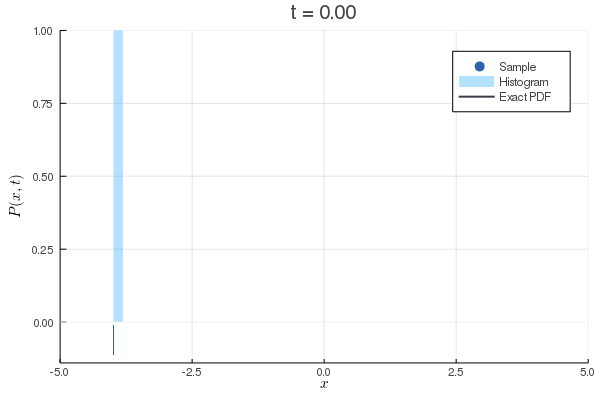

In [212]:
function SDE()    
    # パラメータ：
    N = 5000        # 粒子数
    dt = 0.1        # 時間刻み幅
    step = 50       # 時間ステップ
    name = "SDE_2"  # ファイル名
    x0 = -4         # 初期位置
    Du = 1.5        # 揺動力の強さ(一般には拡散係数Dと一致しない)
    D = Du          # 厳密解の計算で使う拡散係数D
    c = 2.0         # 移流係数
    f(x,t) = c      # 外力のようなもの
    g(x,t) = 1      # 今回は1
    exact(x) = exp(-(x-x0-c*t)^2/(4*Du*t))/sqrt(4*pi*Du*t)

    # 初期値：
    t = 0.0
    X = fill(x0, N)
    Y = [-0.01-0.1*i/N for i in 1:N] # 描写のときのサンプルのy座標. 計算には関係ない
    anim = Animation()

    for i in 1:step
        # 描写：
        plt = scatter(X, Y, xlims=(-5,5), ms=1, msw=0, mc="#3261AB", label="Sample", xlabel="\$x\$", ylabel="\$P(x,t)\$")
        histogram!(plt, X, bins=range(-5,5,step=0.2), ylims=(-0.14,1.0), normed=true, label="Histogram", fa=0.3, fc=1, lc="#FFFFFF")
        plot!(plt, exact, lw=2, lc="#393e46", label="Exact PDF", title= @sprintf("t = %.2f",t))
        frame(anim,plt)
        # 計算：
        t += dt
        X += f.(X,t)*dt + g.(X,t).*sqrt(2*Du*dt).*randn(N)
    end

    gif(anim, name*".gif", fps=15)
end

SDE()

### 数値計算：Ornstein–Uhlenbeck過程

$X(t)$は変位ではなく速度として解釈するほうがよい. つまり, $\gamma$は粘性抵抗である. Ornstein–Uhlenbeck過程はIto方程式の$f(X(t),t)=-\gamma X(t), g(X(t),t)=1$の場合である.

$$
    \frac{{\rm d}X(t)}{{\rm d}t} = -\gamma X(t) + R(t)\\
    {\rm d}X(t) = -\gamma X(t){\rm d}t + {\rm d}W(t)\\
    X(t)-X(t_0) = \int_{t_0}^{t_1} -kX(s){\rm d}s + \int_{t_0}^{t_1} {\rm d}W(s)
$$

Eular-Maruyama法による離散化は次式である.

$$
    X_{i+1} \simeq X_i + c\Delta t + \Delta W_i
$$

対応するFokker-Planck方程式は次式である.

$$
    \frac{\partial P(x,t)}{\partial t}
    = D\frac{\partial^2 P(x,t)}{\partial x^2}
    - \frac{\partial (-\gamma XP(x,t))}{\partial x}
$$

対応する初期条件はそれぞれ

$$
    X(0) = X_0\\
    P(x,0) = \delta(x-x_0)
$$

であり, 境界条件$P(\pm\infty,t)=0$のときの解は次式である. なお, $P(x,t)$は[Wikipedia](https://en.wikipedia.org/wiki/Ornstein%E2%80%93Uhlenbeck_process), [大平(2017) p.166](#参考文献), [堀(2015) p.](#参考文献)に載っている.

$$
    P(x,t) = \sqrt{\frac{\gamma}{2\pi D(1-e^{-2\gamma t})}} \exp \left( -\frac{\gamma(x-x_0 e^{-\gamma t})^2}{2D(1-e^{-2\gamma t})} \right)
$$

f(x)による横方向の移動はEular法で計算しており, 本来ならば短い時間刻みの間にも徐々に移動速度が小さくなっていくべきところを, 大きい速度のまま計算してしまっている. これはdtを小さくするか, 高次のスキームを使うなどすれば改善されるはずである.

┌ Info: Saved animation to 
│   fn = C:\Users\Shuhei\Desktop\GitHub\butsudoi2021\document\SDE_3.gif
└ @ Plots C:\Users\Shuhei\.julia\packages\Plots\qZHsp\src\animation.jl:98


Plots.AnimatedGif("C:\\Users\\Shuhei\\Desktop\\GitHub\\butsudoi2021\\document\\SDE_3.gif")
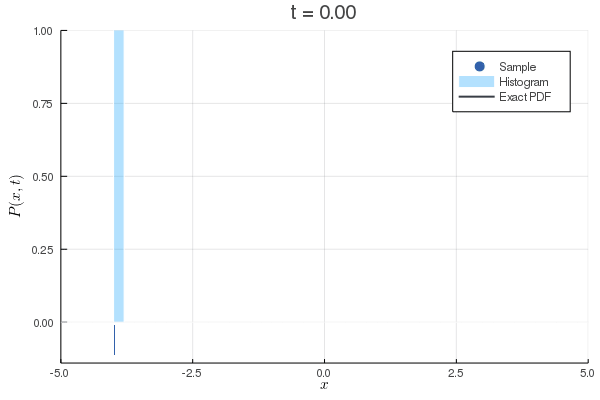

In [213]:
function SDE()    
    # パラメータ：
    N = 5000        # 粒子数
    dt = 0.1        # 時間刻み幅
    step = 50       # 時間ステップ
    name = "SDE_3"  # ファイル名
    x0 = -4         # 初期位置
    Du = 1.5        # 揺動力の強さ(一般には拡散係数Dと一致しない)
    D  = Du         # 厳密解の計算で使う拡散係数D
    γ = 1.5        # 粘性抵抗のようなもの
    f(x,t) = -γ*x  # 外力(粘性抵抗)のようなもの
    g(x,t) = 1      # 今回は1
    exact(x) = exp(-γ*(x-x0*exp(-γ*t))^2/(2*D*(1-exp(-2*γ*t))))*sqrt(γ/(2*pi*D*(1-exp(-2*γ*t))))

    # 初期値：
    t = 0.0
    X = fill(x0, N)
    Y = [-0.01-0.1*i/N for i in 1:N] # 描写のときのサンプルのy座標. 計算には関係ない
    anim = Animation()

    for i in 1:step
        # 描写：
        plt = scatter(X, Y, xlims=(-5,5), ms=1, msw=0, mc="#3261AB", label="Sample", xlabel="\$x\$", ylabel="\$P(x,t)\$")
        histogram!(plt, X, bins=range(-5,5,step=0.2), ylims=(-0.14,1.0), normed=true, label="Histogram", fa=0.3, fc=1, lc="#FFFFFF")
        plot!(plt, exact, lw=2, lc="#393e46", label="Exact PDF", title= @sprintf("t = %.2f",t))
        frame(anim,plt)
        # 計算：
        t += dt
        X += f.(X,t)*dt + g.(X,t).*sqrt(2*Du*dt).*randn(N)
    end

    gif(anim, name*".gif", fps=15)
end

SDE()

## 第３部

第2部の内容を元に, Langevin方程式の数値計算を行う. [北原和夫『岩波基礎物理シリーズ 8 非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html)から平均二乗変位の式を援用し, 計算結果の評価を行う.

[Einstein(1905)](https://doi.org/10.1002/andp.19053220806)は論文中で拡散方程式を用いているが, [Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)はLangevin方程式から等価な結果を導いている. 以下に見るように, 拡散方程式($f(X(t),t)=0, g(X(t),t)=1$のIto方程式)とLangevin方程式の導く平均二乗変位$\langle|X(t)|^2\rangle$は異なるものであるから, どのような近似あるいは粗視化を行っているのか疑問が生ずる. この疑問に答えることが, このノートの最後の目標である. ここまで頑なに揺動力の強さ$D_u$と拡散係数$D$を区別してきた理由は, 拡散係数を求める際によく目にする$\langle|X(t)|^2\rangle = 2nDt$とLangevin方程式から導かれる$\langle|\boldsymbol{X}(t)|^2\rangle = 2n\frac{D_u m}{\gamma^3} \left(\frac{\gamma}{m} t+e^{-\frac{\gamma}{m} t}-1 \right)$を勘違いしないためである.

### Langevin方程式

[Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)で与えられた<b>Langevin方程式</b>は次式である.

> $$m\frac{\mathrm{d}^2 x}{\mathrm{d}t^2} = -6\pi\mu a \frac{\mathrm{d} x}{\mathrm{d}t} + X \tag{3}$$

Langevinが[Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)で与えたLangevin方程式は, Stokesの式$\gamma=6\pi\mu a$と速度$V(t):=\mathrm{d}X(t)/\mathrm{d}t$の定義を使って以下のように書き直せる.

$$
\begin{aligned}
    \frac{\mathrm{d} X(t)}{\mathrm{d}t} &= V(t) \\
    m\frac{\mathrm{d} V(t)}{\mathrm{d}t} &= -\gamma V(t) + R(t)
\end{aligned}
$$

速度$V(t)$の方程式はOrnstein–Uhlenbeck過程として解釈できる.

### Langevin方程式の離散化

速度$V(t)$の方程式にはEular-Maruyama法を, 変位$X(t)$の方程式には通常のEular法を使うとうまくいく.

$$
\begin{aligned}
    X_{i+1} \simeq X_i + V_i\Delta t\\
    V_{i+1} \simeq V_i - \frac{\gamma}{m}\Delta t + \frac{1}{m}\Delta W_i
\end{aligned}
$$

このようにしてBrown運動の軌道を計算できる. しかし, 何を以てこの計算の妥当性を評価するかという問題がある. Ornstein–Uhlenbeck過程の$P(v,t)$は既に明らかになっているが, $P(x,t)$を求めるのは難しそうである. その代わりに, <strong>平均二乗変位</strong>を用いて計算の妥当性を評価する. 

### 平均二乗変位

[北原和夫『岩波基礎物理シリーズ 8 非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html)はp.90の式(4.38)

> $$ m\frac{\mathrm{d}\boldsymbol{u}}{\mathrm{d}t} = -m\gamma\boldsymbol{u} + \boldsymbol{R}(t) \tag{4.38}$$

を出発点とし, p.94の式(4.59)の平均二乗変位を導出している.

> $$\langle|\boldsymbol{x}(t)|^2\rangle = \frac{6k_\mathrm{B}T}{m\gamma^2}(\gamma t+e^{-\gamma t}-1) \tag{4.59}$$

式(4.59)を援用するが, 出発点となる方程式が異なるので, そのままでは上記の計算の検証には使えない. 

### 北原の罠

注意すべき点を述べておく. [北原和夫『岩波基礎物理シリーズ 8 非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html) p.90の式(4.38)や[北原和夫『講談社基礎物理学シリーズ 8 統計力学』(講談社サイエンティフィク, 2010)](https://www.kspub.co.jp/book/detail/1572089.html) p.192の式(12.24)では粘性抵抗を$-m\gamma\boldsymbol{u}$としており, 質量に比例するものとしている. 出発点が異なるため, 平均二乗変位の式(4.59)もそのままでは[Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)の検証には使えない.

この流儀を採用した意図はわからないが, Einsteinの関係式(揺動散逸定理)における質量の寄与を明示的に扱える利点が挙げられる. 粘性抵抗の係数$\gamma$は物体の形状(球ならば半径)のみによって決定されるが, 体積が大きいほど質量も大きくなるので, 間接的には質量にも依存しているから, それを明示的に示すためだったのかもしれない.

$\gamma'=m\gamma$, $D_u=m\gamma k_\mathrm{B}T=\gamma' k_\mathrm{B}T$とし, さらに$n$次元の場合($6\rightarrow2n$)を考えると

$$
    \langle\|\boldsymbol{X}(t)\|^2\rangle = 2n\frac{D_u m}{\gamma'^3} \left(\frac{\gamma'}{m} t+e^{-\frac{\gamma'}{m} t}-1 \right)
$$

となる. これを用いて, Langevin方程式の数値計算の結果を評価する.

また, 熱平衡状態を初期値として仮定しているため, 最初に位置は変化させずに速度だけでBrown運動の計算を行っておく必要がある.

### 数値計算：Langevin方程式（初速0の場合）

初期条件が熱平衡になっていないため, MSDが小さくなっている.

┌ Info: Saved animation to 
│   fn = C:\Users\Shuhei\Desktop\GitHub\butsudoi2021\document\MSD_nonequilibrium.gif
└ @ Plots C:\Users\Shuhei\.julia\packages\Plots\qZHsp\src\animation.jl:98


Plots.AnimatedGif("C:\\Users\\Shuhei\\Desktop\\GitHub\\butsudoi2021\\document\\MSD_nonequilibrium.gif")
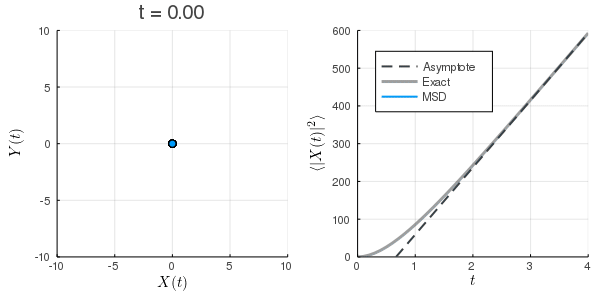

In [227]:
#概要：2次元のLangevin方程式mx"(t)=-γx'(t)+R(t)の平均二乗変位
#環境：Windows 10 Pro x64 (i7-4650U, 8.00GB)
#言語：Julia (Version 1.0.2)
#作成：2019-09-16
#更新：2021-08-26

function MSD_nonequilibrium()
    # パラメータ：
    i_max = 200              # 時間ステップ
    N  = 2000                # 粒子数
    m  = 0.1                 # 質量
    Du = 1.0                 # 揺動力の強さ(拡散係数Dではない)
    γ = 0.15                # 粘性抵抗の強さ
    dt = 0.02                # 時間刻み幅
    T = fill(NaN,i_max)
    MSD = fill(NaN,i_max)
    anim = Animation()

    # 初期値：
    t = 0.0
    X = zeros(N)
    Y = zeros(N)
    U = zeros(N)
    V = zeros(N)
    # for i in 1:i_max
    #     U = U - γ/m*U*dt + 1/m*sqrt(2*Du*dt)*randn(N) # 熱平衡化
    #     V = V - γ/m*V*dt + 1/m*sqrt(2*Du*dt)*randn(N) # 熱平衡化
    # end
    T[1] = t
    MSD[1] = (sum(X.^2) + sum(Y.^2))/N

    # 実行：
    for i in 1:i_max
        # 描写：
        plt1 = scatter(X, Y, xlims=(-10,10), ylims=(-10,10), label="", xlabel="\$X(t)\$", ylabel="\$Y(t)\$", title=@sprintf("t = %.2f",t))
        plt2 = plot(0:0.1:4, t->4*Du*m/(γ^3)*(γ/m*t             -1), xlim=(0,4), ylim=(0,600), label="Asymptote", lc="#393e46", lw=2, ls=:dash)
        plot!(plt2, 0:0.1:4, t->4*Du*m/(γ^3)*(γ/m*t+exp(-γ/m*t)-1), xlim=(0,4), ylim=(0,600), label="Exact", lc="#393e46", lw=3, la=0.5)
        plot!(plt2, T, MSD, label="MSD", xlabel="\$t\$", ylabel="\$\\langle |X(t)|^2 \\rangle\$", lc=1, lw=2, legend=:topleft)
        frame(anim, plot(plt1, plt2, size=(600,300)))
        # 計算：
        t = t + dt
        U = U - γ/m*U*dt + 1/m*sqrt(2*Du*dt)*randn(N)
        V = V - γ/m*V*dt + 1/m*sqrt(2*Du*dt)*randn(N)
        X = X + U*dt
        Y = Y + V*dt
        T[i] = t
        MSD[i] = (sum(X.^2) + sum(Y.^2))/N
    end
    gif(anim, "MSD_nonequilibrium.gif", fps = 60)
end

MSD_nonequilibrium()

### 数値計算：Langevin方程式

正しく熱平衡状態を初期条件としたため, 解析的に求めたMSDに一致している.

┌ Info: Saved animation to 
│   fn = C:\Users\Shuhei\Desktop\GitHub\butsudoi2021\document\MSD.gif
└ @ Plots C:\Users\Shuhei\.julia\packages\Plots\qZHsp\src\animation.jl:98


Plots.AnimatedGif("C:\\Users\\Shuhei\\Desktop\\GitHub\\butsudoi2021\\document\\MSD.gif")
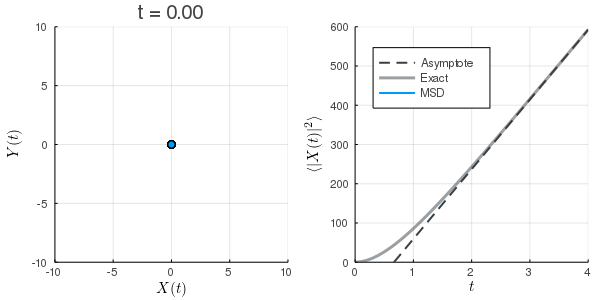

In [229]:
#概要：2次元のLangevin方程式mx"(t)=-γx'(t)+R(t)の平均二乗変位
#環境：Windows 10 Pro x64 (i7-4650U, 8.00GB)
#言語：Julia (Version 1.0.2)
#作成：2019-09-16
#更新：2021-08-26

function MSD()
    # パラメータ：
    i_max = 200              # 時間ステップ
    N  = 2000                # 粒子数
    m  = 0.1                 # 質量
    Du = 1.0                 # 揺動力の強さ(拡散係数Dではない)
    γ = 0.15                # 粘性抵抗の強さ
    dt = 0.02                # 時間刻み幅
    T = fill(NaN,i_max)
    MSD = fill(NaN,i_max)
    anim = Animation()

    # 初期値：
    t = 0.0
    X = zeros(N)
    Y = zeros(N)
    U = zeros(N)
    V = zeros(N)
    for i in 1:i_max
        U = U - γ/m*U*dt + 1/m*sqrt(2*Du*dt)*randn(N) # 熱平衡化
        V = V - γ/m*V*dt + 1/m*sqrt(2*Du*dt)*randn(N) # 熱平衡化
    end
    T[1] = t
    MSD[1] = (sum(X.^2) + sum(Y.^2))/N

    # 実行：
    for i in 1:i_max
        # 描写：
        plt1 = scatter(X, Y, xlims=(-10,10), ylims=(-10,10), label="", xlabel="\$X(t)\$", ylabel="\$Y(t)\$", title=@sprintf("t = %.2f",t))
        plt2 = plot(0:0.1:4, t->4*Du*m/(γ^3)*(γ/m*t             -1), xlim=(0,4), ylim=(0,600), label="Asymptote", lc="#393e46", lw=2, ls=:dash)
        plot!(plt2, 0:0.1:4, t->4*Du*m/(γ^3)*(γ/m*t+exp(-γ/m*t)-1), xlim=(0,4), ylim=(0,600), label="Exact", lc="#393e46", lw=3, la=0.5)
        plot!(plt2, T, MSD, label="MSD", xlabel="\$t\$", ylabel="\$\\langle |X(t)|^2 \\rangle\$", lc=1, lw=2, legend=:topleft)
        frame(anim, plot(plt1, plt2, size=(600,300)))
        # 計算：
        t = t + dt
        U = U - γ/m*U*dt + 1/m*sqrt(2*Du*dt)*randn(N)
        V = V - γ/m*V*dt + 1/m*sqrt(2*Du*dt)*randn(N)
        X = X + U*dt
        Y = Y + V*dt
        T[i] = t
        MSD[i] = (sum(X.^2) + sum(Y.^2))/N
    end
    gif(anim, "MSD.gif", fps = 60)
end

MSD()

### 拡散係数の過小評価

拡散方程式($f(X(t),t)=0, g(X(t),t)=1$のIto方程式)とLangevin方程式の導く平均二乗変位$\langle|X(t)|^2\rangle$は異なる. 拡散係数を実験あるいは分子動力学法によって決定するとき, 

$$
    \lim_{t\rightarrow\infty} \langle|\boldsymbol{X}(t)|^2\rangle = 2nDt
$$

を用いることが多い. ここでは, 長時間極限$t\rightarrow\infty$の必要性や, 式そのものの正当性について論じる. 以下では, 簡単のため$n=1$の場合について考察する. まず, 粒子の分布が厳密に拡散方程式

$$
    \frac{\partial P(x,t)}{\partial t}=D\frac{\partial^2 P(x,t)}{\partial x^2}
$$

に従う場合, 初期条件$P(x,0) = \delta(x-x_0)$に対する解は

$$
    P(x,t) = \frac{1}{\sqrt{4\pi Dt}} \exp \left( -\frac{(x-x_0)^2}{4Dt} \right)
$$

であることが知られているので, $x_0=0$として平均二乗変位は厳密に

$$
    \langle X^2(t)\rangle = \int_{-\infty}^{\infty} x^2 P(x,t) \mathrm{d}x = 2Dt
$$

と求められる. (計算の詳細は[Wolfram Alpha](https://ja.wolframalpha.com/input/?i2d=true&i=Integrate%5BDivide%5BPower%5Bx%2C2%5D%2CSqrt%5B%CF%80a%5D%5DExp%5B-Divide%5BPower%5Bx%2C2%5D%2Ca%5D%5D%2C%7Bx%2C-%E2%88%9E%2C%E2%88%9E%7D%5D)を参照せよ. 式の意味がわからない読者は確率密度関数や期待値などの概念について復習することを勧める.) このことから, 長時間極限$t\rightarrow\infty$が必要である理由は, 実際のBrown粒子が拡散方程式には従わないからであると言える. しかし, [Einstein(1905)](https://doi.org/10.1002/andp.19053220806)は$\langle |X(t)|^2\rangle = 2Dt$を用いてアボガドロ定数を算出することに成功しているため, 実在の粒子は拡散方程式に従わないにしても, 何らかの条件の下では拡散方程式に近い振る舞いをすることが予想される.

まず1つ目の条件は, [米沢登美子『物理学 One Point - 27 ブラウン運動』(共立出版, 1986) p.90](https://www.kyoritsu-pub.co.jp/bookdetail/9784320032361)にも議論がある通り, 長時間間隔での観測, すなわち時間軸での粗視化を行うことである. 既に見たように, 白色雑音$\langle R(t_1)R(t_2) \rangle = 2D_u \delta(t_1-t_2)$を含むLangevin方程式

$$
    m\frac{\mathrm{d} V(t)}{\mathrm{d}t} = -\gamma V(t) + R(t)
$$

からは平均二乗変位

$$
    \langle|\boldsymbol{X}(t)|^2\rangle = 2n\frac{D_u m}{\gamma^3} \left(\frac{\gamma}{m} t+e^{-\frac{\gamma}{m} t}-1 \right)
$$

が導かれる. 長時間極限$t\rightarrow\infty$では$e^{-\gamma t}\rightarrow0$となり, 定数項も相対的には無視できることから, 第1項が支配的となり, 

$$
    \langle|\boldsymbol{X}(t)|^2\rangle \rightarrow 2n\frac{D_u m}{\gamma^3} \frac{\gamma}{m} t
$$

と考えることができる. さらに, これを$\langle|\boldsymbol{X}(t)|^2\rangle = 2nDt$と見比べ, $D_u=\gamma k_\mathrm{B}T$を代入すると, よく目にするEinsteinの関係式（揺動散逸定理）

$$
    D = \frac{D_u}{\gamma^2} = \frac{k_\mathrm{B}T}{\gamma}
$$

が得られる. すなわち, どのような粒子であっても十分に長い時間間隔で観測すれば, 拡散係数$D_u/\gamma^2$の拡散方程式に従うと考えられる. 問題は, 「十分に長い」とは具体的に何sなのかということである. 分子動力学法ではせいぜい数百ns～数十μsを追うのが限度であるから, 仮に1sが必要であったとすると, 分子動力学法によって拡散係数を正確に決定するのは絶望的である. 具体的な時間間隔の見積もりは読者に任せる.

次に, 2つ目の条件を紹介する. 長時間極限$t\rightarrow\infty$を満たさずとも, $\frac{\gamma}{m}\rightarrow0$という条件が満足されることによって簡単に拡散方程式の振る舞いに近づく. $\frac{\gamma}{m}\rightarrow0$では$e^{-\frac{\gamma}{m} t}\rightarrow1$となるため定数項と打ち消し合って, 第1項のみが残る. 平均二乗変位は拡散方程式のものと一致する. 半径$a$の均質な球を仮定すればStokesの式より$\gamma\propto a$, 密度の定義より$m\propto a^3$であるから, $\frac{\gamma}{m}\propto \frac{1}{a^2}$となるので, 半径について$a\rightarrow\infty$であれば拡散方程式に従うことになる. 分子サイズの対象についても拡散方程式に従うと見なせるか, という疑問も分子動力学法の観点からは重要であると思われるので, この見積もりを行った読者がいれば結果を報告されたい.

いずれの場合においても, 有限の時間しか扱えないため, 下図の通り拡散係数（傾き）を過少評価することになる. 
<!-- 分子動力学法によって拡散係数を決定しようとする読者については, 長時間の計算を行うだけでなく, $\gamma$の見積もりを行うことを勧める. -->

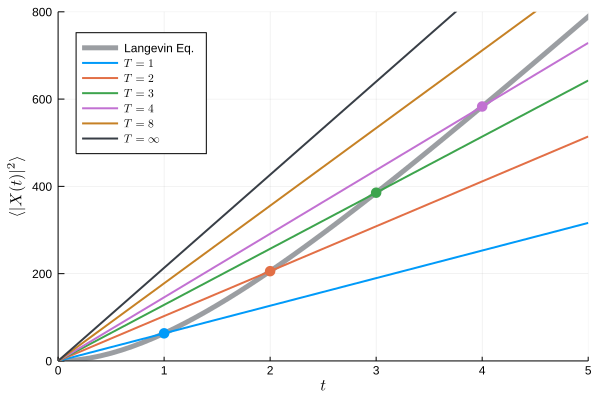

In [226]:
m  = 0.2   # 質量
Du = 1.2   # 揺動力の強さ(拡散係数Dではない)
γ = 0.15  # 粘性抵抗の強さ
Langevin(t) = 4*Du*m/(γ^3)*(γ/m*t+exp(-γ/m*t)-1)
Diffusion(t) = 4*Du/γ^2*t
plot(ylim=(0,800), xlim=(0,5), xlabel="\$t\$", ylabel="\$\\langle |X(t)|^2 \\rangle\$", legend=:topleft)
plot!(0:0.1:8, t->Langevin(t), label="Langevin Eq.", lc="#393e46", lw=5, la=0.5)
for T in [1,2,3,4,8]
    plot!(t->Langevin(T)/T*t, lw=2, lc=T, label="\$T = $T\$")
    scatter!([T], [Langevin(T)], mc=T, ms=6, msw=0, label="")
end
plot!(t->Diffusion(t), lw=2, lc="#393e46", label="\$T = \\infty\$")
plot!()

savefig("MSD.svg")
plot!()

## おわりに

数値計算としては満足できる結果が得られているが, いくつかやり残した点や生じた疑問についてまとめておく.

1. まず, $\Delta W$の計算に表れる$\sqrt{\Delta t}$という量については違和感を覚える. 恐らくフラクタル次元が2であるために, このような次元のおかしな量が現れるのだと思われる.
2. 分子動力学法によって平均二乗変位を求める際の誤差や適用限界について見積もることも目標にしていたが, これについては実際に分子動力学法を使用している読者に任せたい.
3. 時間の都合上, 紹介に留めるが. このノートの内容の興味深い応用例として https://arxiv.org/abs/1303.1101 がある.

### 参考文献

#### 第１部

- [池田信行『偶然の輝き ブラウン運動を巡る2000年』(岩波書店, 2018)](https://www.iwanami.co.jp/book/b427307.html) 第3章, 第4章, 第5章<br>和書の中では, Brown運動を最も広く深く解説している本だと思われる.
- [米沢登美子『物理学 One Point - 27 ブラウン運動』(共立出版, 1986)](https://www.kyoritsu-pub.co.jp/bookdetail/9784320032361) pp.6,44-47,59,62,119<br>Brown運動に興味があるならば最初に読んでおくべき本である. BrownやPerrinの実験についても詳しく解説されている.
- [ジョン・スタチェル編, 青木薫訳『アインシュタイン論文選「奇跡の年」の5論文』(筑摩書房, 2011)](https://www.chikumashobo.co.jp/product/9784480094032/) pp.191,192,194,196<br>Einsteinの原論文の和訳と解説がある. 解説は上記と被る部分が多いが, 違う切り口で解説されている.
- [兼清泰明『確率微分方程式とその応用』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007781) p.1 <br> [Bachelier(1900)](https://doi.org/10.24033/asens.476)について言及がある.
- [ぺランのノーベル賞スピーチ](https://www.nobelprize.org/prizes/physics/1926/ceremony-speech/)
- [伊藤清先生の数学](https://www.mathsoc.jp/publication/tushin/2004/2004watanabe.pdf)
- [Brown(1828)](https://doi.org/10.1080/14786442808674769)
- [Bachelier(1900)](https://doi.org/10.24033/asens.476)
- [Einstein(1905)](https://doi.org/10.1002/andp.19053220806)
- [Perrin(1909)](https://hal.archives-ouvertes.fr/jpa-00242381)
- [Langevin(1908)](https://fr.wikisource.org/wiki/Sur_la_th%C3%A9orie_du_mouvement_brownien)
- [Wiener(1923)](https://doi.org/10.1002/sapm192321131)

#### 第２部

- [太田隆夫『非平衡系の物理学』(裳華房, 2000)](https://www.shokabo.co.jp/mybooks/ISBN978-4-7853-2092-8.htm) p.67 <br> ランダムウォークモデルの連続極限として拡散方程式を導出している. 拡散方程式を経由して, Wiener過程とランダムウォークの対応関係を考えるときに参考になる.
- [石村直之『確率微分方程式入門―数理ファイナンスへの応用― 』(共立出版, 2014)](https://www.kyoritsu-pub.co.jp/bookdetail/9784320110670) pp.6,74,75 <br> 確率過程や確率微分方程式の定義を参考にした.
- [大平徹『確率論 講義ノート 場合の数から確率微分方程式まで』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007771) pp.118,160,165,166,167 <br> 確率過程の定義を参考にした. Ornstein–Uhlenbeck過程の解が載っている.
- [兼清泰明『確率微分方程式とその応用』(森北出版, 2017)](https://www.morikita.co.jp/books/mid/007781) p.1,100,102 <br> 白色雑音を取り巻く数学的な困難さについて述べられている. Ito-Taylor展開を用いた近似スキームの導出はこちらを参考にされたい.
- [B.エクセンダール著, 谷口説男訳『確率微分方程式 入門から応用まで』(丸善出版, 2012)](https://www.maruzen-publishing.co.jp/item/b294235.html) 
- [L.カラザス, S.E.シュレーブ著, 渡邉壽夫訳『ブラウン運動と確率積分』(丸善出版, 2012)](https://www.maruzen-publishing.co.jp/item/?book_no=294581)
- [堀淳一『ランジュバン方程式』(岩波書店, 2015)](https://www.iwanami.co.jp/book/b266718.html) pp.4, 53, 54, 61, 80 <br> 数学的にも厳密であり, かつ物理への応用例が非常に充実している. 白色雑音についての困難さについても述べられており, Ito積分やItoのLangevin方程式についての説明がある. Ito方程式の定義はこれを参考にした.
- [三井斌友, 小藤俊幸, 斉藤善弘『微分方程式による計算科学入門』(共立出版, 2004)](https://www.kyoritsu-pub.co.jp/bookdetail/9784320017535) pp.139, 150<br> SDEの数値計算について解説している希少な和書である. Eular-Maruyama法の表記はこれを参考にした.

####  第３部

- [北原和夫『講談社基礎物理学シリーズ 8 統計力学』(講談社サイエンティフィク, 2010)](https://www.kspub.co.jp/book/detail/1572089.html) p.192
- [北原和夫『岩波基礎物理シリーズ 8 非平衡系の統計力学』(岩波書店, 1997)](https://www.iwanami.co.jp/book/b258377.html) pp.94 <br> 知る限りでは最も一般的な立場から書かれた非平衡統計力学の教科書である. 3次元のLangevin方程式やFokker-Planck方程式, 平均二乗変位などを解説しており, かつ慣性項の取り扱いをきちんと議論している文献は見たことがない.

### 補助資料

以下のノートも参照されたい.

- [Plots.jl](https://gist.github.com/ohno/78d55921c3f88b50a7fb1835be132bcd)
- [拡散方程式](https://gist.github.com/ohno/1eccdd8d6e04e41683095c2e693a9b1b)
- [ランダムウォークモデル](https://gist.github.com/ohno/8645edfe0a12c95b87f57ab7191fd966)
- [Brown運動の歴史](https://gist.github.com/ohno/8559aa1ac4f3a233b7059f31c20825a4)
- [Langevin方程式の数値計算](https://gist.github.com/ohno/1cac40f90ae41bf79d94a54f3fe1b210)

© 2021 Shuhei Ohno
<br>Source: https://github.com/ohno/butsudoi2021
<br>License: https://opensource.org/licenses/MIT